In [1]:
using Pkg
pwd()

"D:\\proj\\user01"

In [2]:
versioninfo()

Julia Version 1.9.0
Commit 8e63055292 (2023-05-07 11:25 UTC)
Platform Info:
  OS: Windows (x86_64-w64-mingw32)
  CPU: 16 × 13th Gen Intel(R) Core(TM) i5-1340P
  WORD_SIZE: 64
  LIBM: libopenlibm
  LLVM: libLLVM-14.0.6 (ORCJIT, goldmont)
  Threads: 2 on 16 virtual cores


# GR backend를 이용한 plot 그리기 예제

Julia의 Plots.jl 패키지는 다양한 backend를 사용합니다. 

> **(사용 백엔드)** GR, Plotly/PlotlyJS, MathJax, PythonPlot, PGFPlotsX, UnicodePlots, Gaston, InspectDR, HDF5 등
>
> **(지원 중단 백엔드)** PyPlot, PGFPlots, Gadfly, Immerse, Qwt, Bokeh, Winston 등


그 중 그래프 생성 및 렌더링을 위한 고성능 C 라이브러리인 GR을 이용하는 예제를 살펴보겠습니다. 

In [3]:
# Package 불러오기
using Plots
gr()

Plots.GRBackend()

## 1. line 그래프

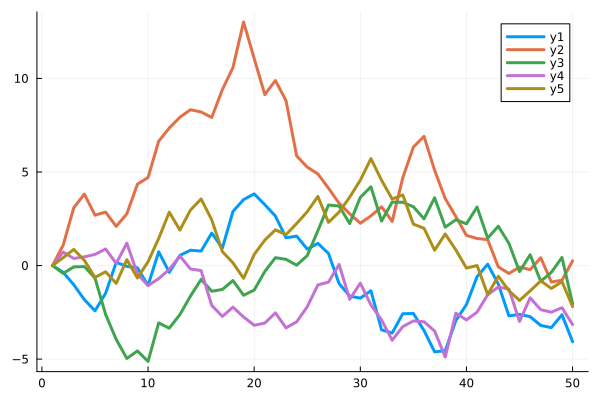

In [4]:
plot(Plots.fakedata(50, 5), w = 3)

## 2. Animation 그래프

[ Info: Saved animation to D:\proj\user01\assets\anim_gr_ref002.gif


Plots.AnimatedGif("D:\\proj\\user01\\assets\\anim_gr_ref002.gif")
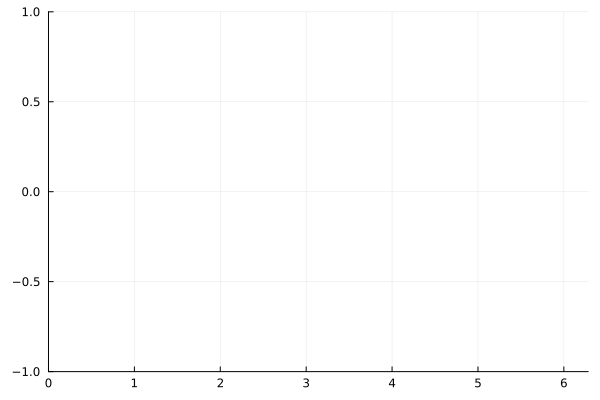

In [5]:
p = plot([sin, cos], zeros(0), leg = false, xlims = (0, 2π), ylims = (-1, 1))
anim = Animation()
for x = range(0, stop = 2π, length = 20)
    push!(p, x, Float64[sin(x), cos(x)])
    frame(anim)
end
gif(anim, "assets/anim_gr_ref002.gif")

## 3. Parametric 그래프

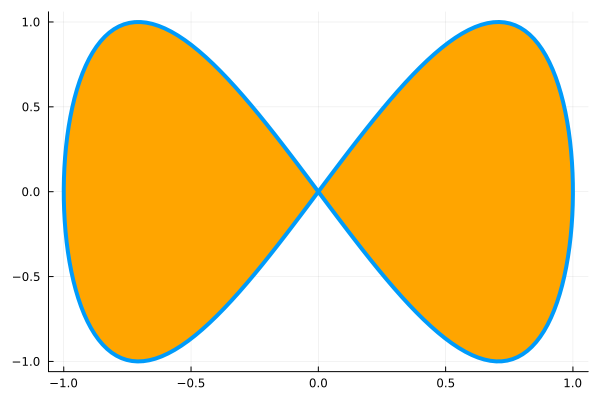

In [6]:
plot(sin, (x->begin
            sin(2x)
        end), 0, 2π, line = 4, leg = false, fill = (0, :orange))

## 4. Color 변경 예제

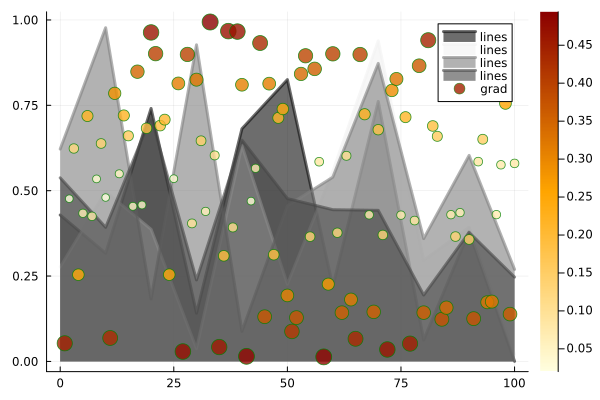

In [7]:
y = rand(100)
plot(0:10:100, rand(11, 4), lab = "lines", w = 3, palette = cgrad(:grays), fill = 0, α = 0.6)
scatter!(y, zcolor = abs.(y .- 0.5), m = (:heat, 0.8, Plots.stroke(1, :green)), ms = 10 * abs.(y .- 0.5) .+ 4, lab = "grad")

## 5. plot 환경 요소 변경 예제

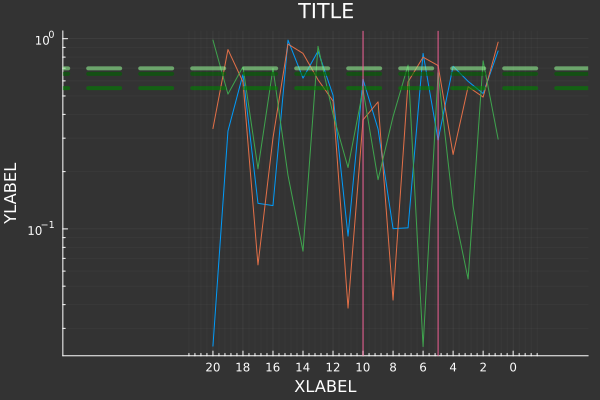

In [8]:
using Statistics
y = rand(20, 3)
plot(y, xaxis = ("XLABEL", (-5, 30), 0:2:20, :flip), background_color = RGB(0.2, 0.2, 0.2), leg = false)
hline!(mean(y, dims = 1) + rand(1, 3), line = (4, :dash, 0.6, [:lightgreen :green :darkgreen]))
vline!([5, 10])
title!("TITLE")
yaxis!("YLABEL", :log10, minorgrid = true)

## 6. 웹 상 이미지 다운로드 후 그래프로 나타내기

In [9]:
using FileIO

In [10]:
import Downloads

In [11]:
path = Downloads.download("http://juliaplots.org/PlotReferenceImages.jl/Plots/pyplot/0.7.0/ref1.png")

"C:\\Users\\BEGAS-~1\\AppData\\Local\\Temp\\jl_faBMJsJe3S"

In [12]:
path

"C:\\Users\\BEGAS-~1\\AppData\\Local\\Temp\\jl_faBMJsJe3S"

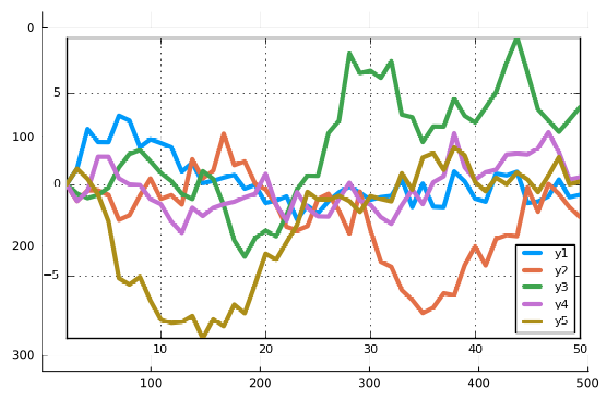

In [15]:
img2 = FileIO.load(path)
plot(img2)

In [16]:
# import Pkg; Pkg.add("FileIO")

## 7. Marker와 Markersize 등 변경

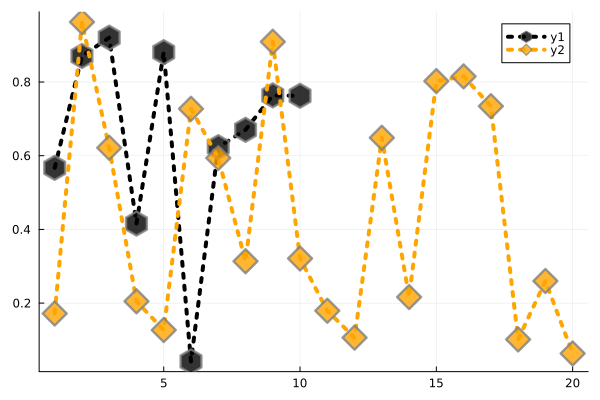

In [17]:
plot([rand(10), rand(20)], color = [:black :orange], line = (:dot, 4), marker = ([:hex :d], 12, 0.8, Plots.stroke(3, :gray)))

## 8. base plot 이용하기

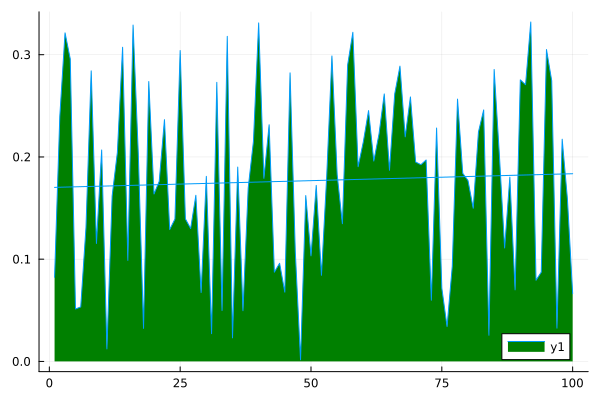

In [75]:
plot(rand(100) / 3, reg = true, fill = (0, :green))

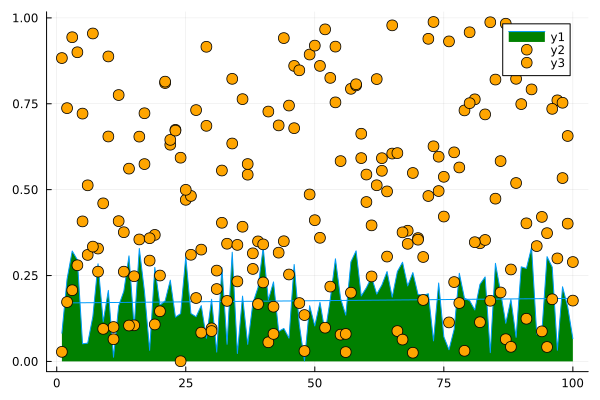

In [77]:
# 덧붙여 그려줄 때는 plot하는 함수에 !를 붙임

scatter!(rand(100), markersize = 6, c = :orange)

## 9. 2D-histogram

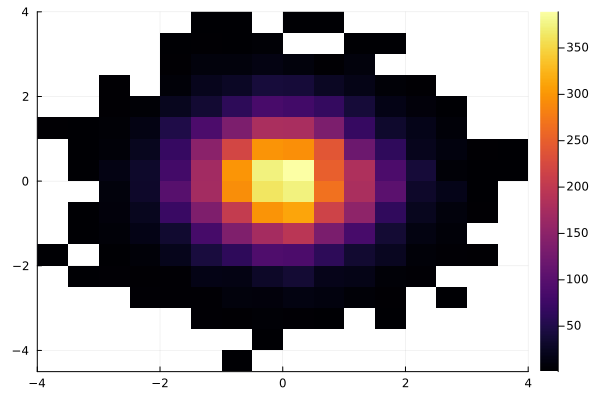

In [19]:
histogram2d(randn(10000), randn(10000), nbins = 20)

## 10. 혼합형 line 그래프

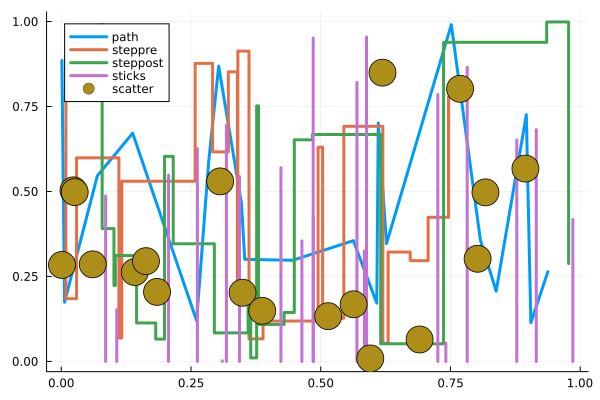

In [20]:
linetypes = [:path :steppre :steppost :sticks :scatter]
n = length(linetypes)
x = map((_->begin
                sort(rand(20))
            end), 1:n)
y = rand(20, n)
plot(x, y, line = (linetypes, 3), lab = map(string, linetypes), ms = 15)

## 11. line 그래프의 스타일 변경

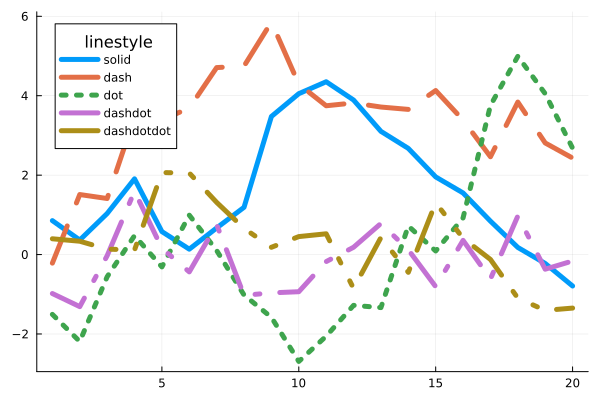

In [21]:
styles = filter((s->begin
                s in Plots.supported_styles()
            end), [:solid, :dash, :dot, :dashdot, :dashdotdot])
styles = reshape(styles, 1, length(styles))
plot(cumsum(randn(20, length(styles)), dims = 1), 
    line = (5, styles), 
    label = map(string, styles), 
    legendtitle = "linestyle")

## 12. Marker 타입 나타내기

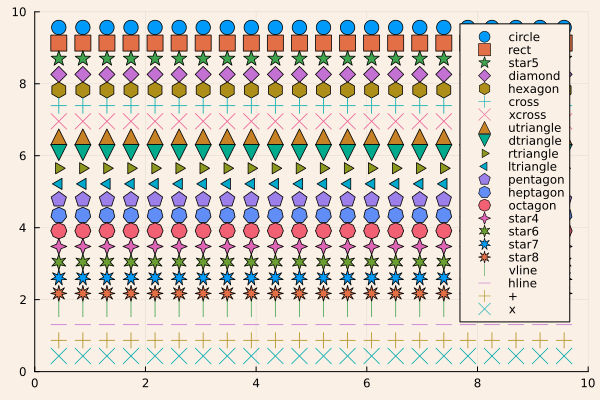

In [22]:
markers = filter((m->begin
                m in Plots.supported_markers()
            end), Plots._shape_keys)
markers = permutedims(markers)
n = length(markers)
x = (range(0, stop = 10, length = n + 2))[2:end - 1]
y = repeat(reshape(reverse(x), 1, :), n, 1)
scatter(x, y, m = markers, markersize = 8, lab = map(string, markers), bg = :linen, xlim = (0, 10), ylim = (0, 10))

## 13. Bar 그래프 그리기

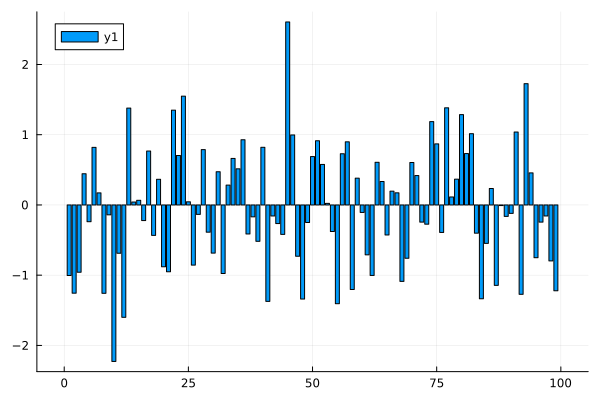

In [23]:
bar(randn(99))

## 14. Histogram 그리기

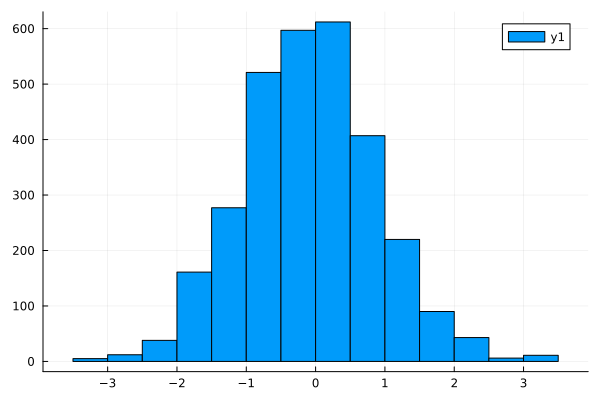

In [24]:
histogram(randn(1000), bins = :scott, weights = repeat(1:5, outer = 200))

## 15. subplot 그리기

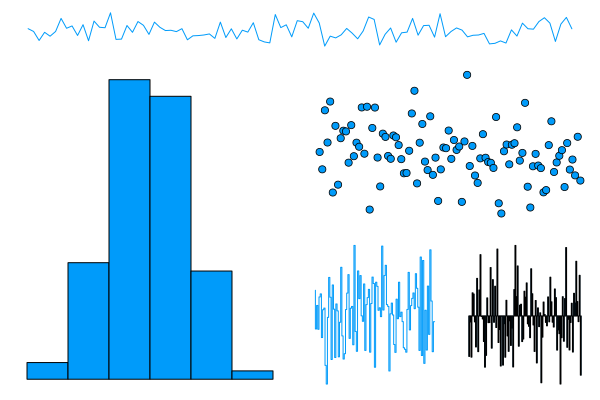

In [25]:
l = @layout([a{0.1h}; b [c; d e]])
plot(randn(100, 5), layout = l, t = [:line :histogram :scatter :steppre :bar], leg = false, ticks = nothing, border = :none)

## 16. 자동 grid layout 이용 subplot 그리기

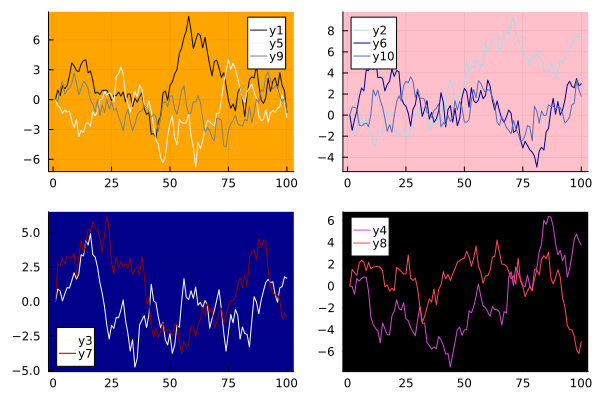

In [78]:
plot(Plots.fakedata(100, 10), layout = 4, palette = cgrad.([:grays :blues :heat :lightrainbow]), bg_inside = [:orange :pink :darkblue :black])

## 17. OHLC 그래프 그리기 (open, high, low, cloase)

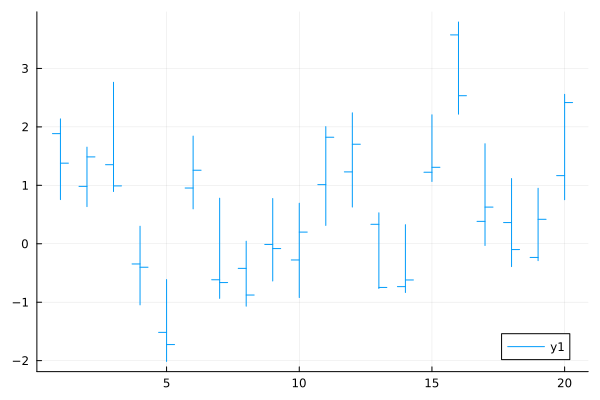

In [27]:
n = 20
hgt = rand(n) .+ 1
bot = randn(n)
openpct = rand(n)
closepct = rand(n)
y = OHLC[(openpct[i] * hgt[i] + bot[i], bot[i] + hgt[i], bot[i], closepct[i] * hgt[i] + bot[i]) for i = 1:n]
ohlc(y)

## 18. Annotations 넣기

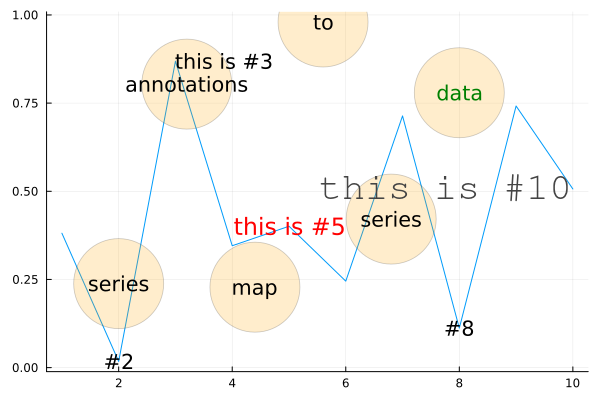

In [79]:
y = rand(10)
plot(y, annotations = (3, y[3], Plots.text("this is #3", :left)), leg = false)
annotate!([(5, y[5], ("this is #5", 16, :red, :center)), (10, y[10], ("this is #10", :right, 20, "courier"))])
annotate!([2, 8], y[[2, 8]], ["#2", "#8"])
scatter!(range(2, stop = 8, length = 6), rand(6), marker = (50, 0.2, :orange), series_annotations = ["series", "annotations", "map", "to", "series", Plots.text("data", :green)])

## 19. Custom Markers 넣기

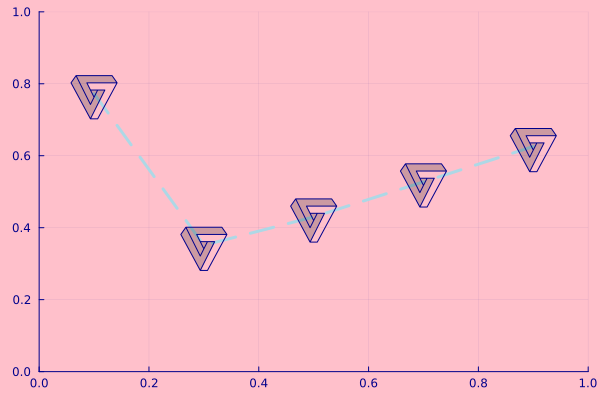

In [29]:
verts = [(-1.0, 1.0), (-1.28, 0.6), (-0.2, -1.4), (0.2, -1.4), (1.28, 0.6), (1.0, 1.0), (-1.0, 1.0), (-0.2, -0.6), (0.0, -0.2), (-0.4, 0.6), (1.28, 0.6), (0.2, -1.4), (-0.2, -1.4), (0.6, 0.2), (-0.2, 0.2), (0.0, -0.2), (0.2, 0.2), (-0.2, -0.6)]
plot(0.1:0.2:0.9, 0.7 * rand(5) .+ 0.15, line = (3, :dash, :lightblue), marker = (Shape(verts), 30, RGBA(0, 0, 0, 0.2)), bg = :pink, fg = :darkblue, xlim = (0, 1), ylim = (0, 1), leg = false)

## 20. contours(등고선) 그리기

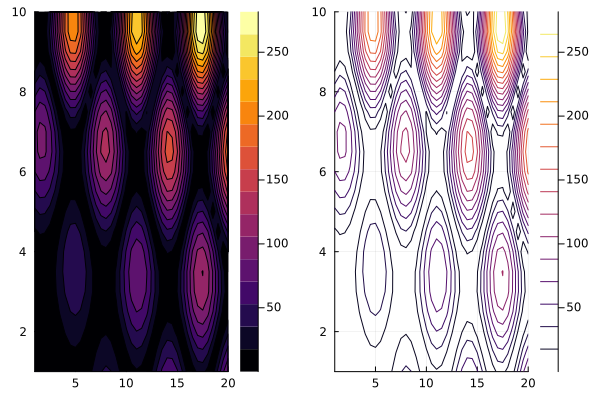

In [30]:
x = 1:0.5:20
y = 1:0.5:10
f(x, y) = begin
        (3x + y ^ 2) * abs(sin(x) + cos(y))
    end
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(y, 1, length(x))
Z = map(f, X, Y)
p1 = contour(x, y, f, fill = true)
p2 = contour(x, y, Z)
plot(p1, p2)

## 21. Pie 차트(원 그래프 그리기)

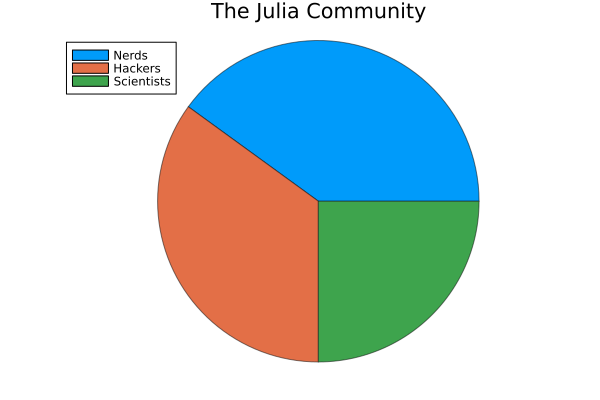

In [31]:
x = ["Nerds", "Hackers", "Scientists"]
y = [0.4, 0.35, 0.25]
pie(x, y, title = "The Julia Community", l = 0.5)

## 22. 3D 그래프 그리기

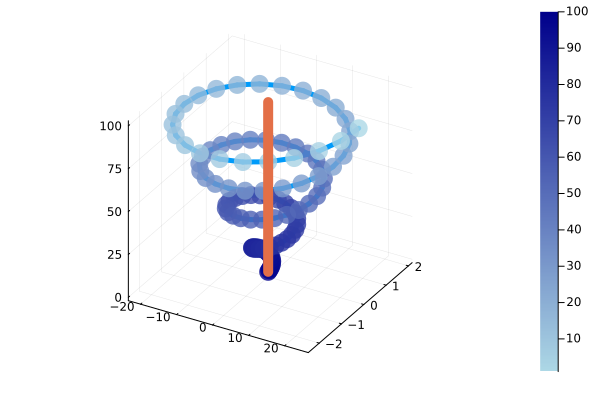

In [32]:
n = 100
ts = range(0, stop = 8π, length = n)
z = 1:n
plot(ts .* map(cos, ts), (0.1ts) .* map(sin, ts), z, zcolor = reverse(z), m = (10, 0.8, :blues, Plots.stroke(0)), leg = false, cbar = true, w = 5)
plot!(zeros(n), zeros(n), 1:n, w = 10)

## 23. DataFrames 이용하기

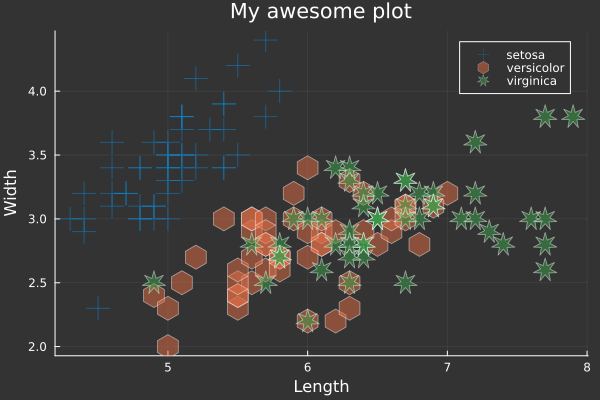

In [34]:
using StatsPlots, RDatasets
iris = RDatasets.dataset("datasets", "iris")
@df iris scatter(:SepalLength, :SepalWidth, 
                 group = :Species, 
                 title = "My awesome plot", 
                 xlabel = "Length", 
                 ylabel = "Width", 
                 marker = (0.5, [:cross :hex :star7], 12), 
                 bg = RGB(0.2, 0.2, 0.2))

## 24.Groups and Subplots 그리기

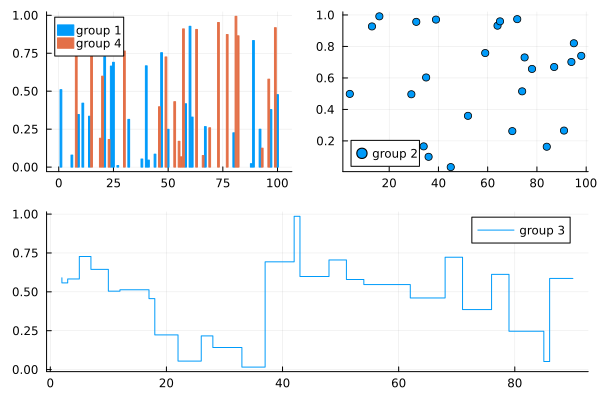

In [35]:
group = rand(map((i->begin
                    "group $(i)"
                end), 1:4), 100)
plot(rand(100), 
     layout = @layout([a b; c]), 
     group = group, 
     linetype = [:bar :scatter :steppre], 
     linecolor = :match)

## 25. Polar 그리기

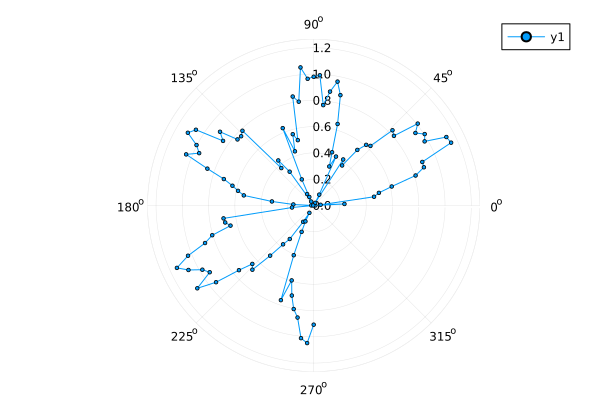

In [36]:
Θ = range(0, stop = 1.5π, length = 100)
r = abs.(0.1 * randn(100) + sin.(3Θ))
plot(Θ, r, proj = :polar, m = 2)

## 27. 히트맵 그리기

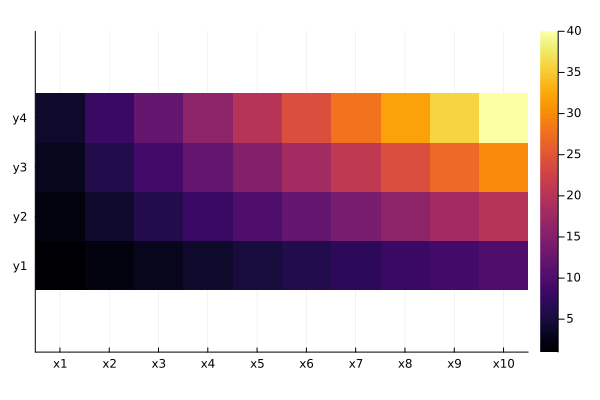

In [37]:
xs = [string("x", i) for i = 1:10]
ys = [string("y", i) for i = 1:4]
z = float((1:4) * reshape(1:10, 1, :))
heatmap(xs, ys, z, aspect_ratio = 1)

## 28. 레이아웃 바꿔주기

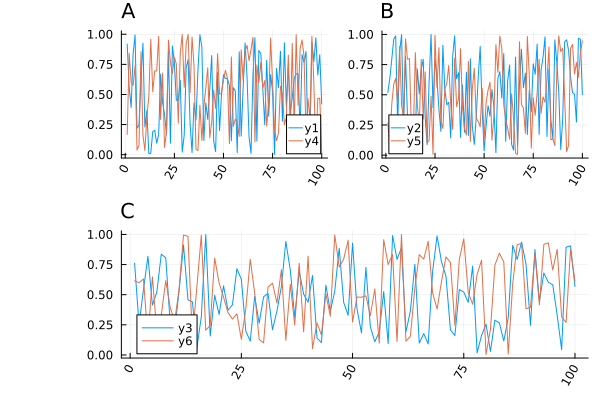

In [38]:
using Plots.PlotMeasures
plot(rand(100, 6), 
    layout = @layout([a b; c]), 
    title = ["A" "B" "C"], 
    titlelocation = :left, 
    left_margin = [20mm 0mm],
    bottom_margin = 10px, xrotation = 60)

## 29. Box plot 및 violin plot

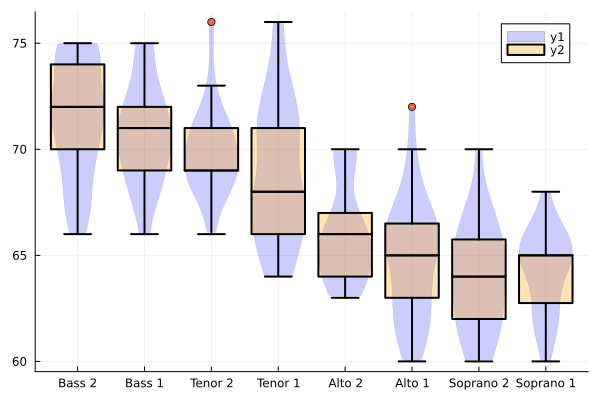

In [39]:
using StatsPlots, RDatasets
singers = RDatasets.dataset("lattice", "singer")
@df singers violin(:VoicePart, 
                    :Height, 
                    line = 0, 
                    fill = (0.2, :blue))
@df singers boxplot!(:VoicePart, :Height, 
                    line = (2, :black), 
                    fill = (0.3, :orange))

## 30. subplot으로 애니메이션 그리기

[ Info: Saved animation to D:\proj\user01\assets\anim_gr_ref031.gif


Plots.AnimatedGif("D:\\proj\\user01\\assets\\anim_gr_ref031.gif")
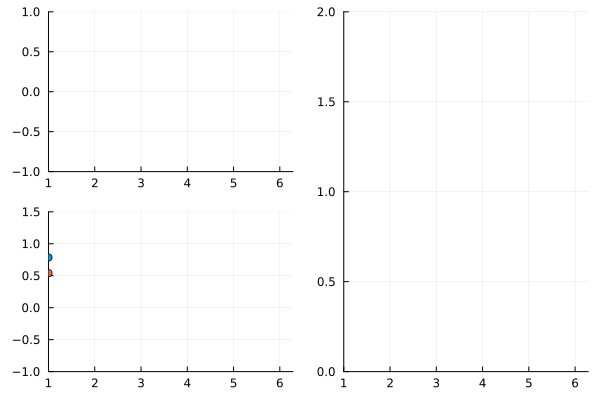

In [40]:
l = @layout([[a; b] c])
p = plot(plot([sin, cos], 1, ylims = (-1, 1), leg = false), 
         scatter([atan, cos], 1, ylims = (-1, 1.5), leg = false), 
         plot(log, 1, ylims = (0, 2), leg = false), layout = l, xlims = (1, 2π))
anim = Animation()

for x = range(1, stop = 2π, length = 20)
    plot(push!(p, x, Float64[sin(x), cos(x), atan(x), cos(x), log(x)]))
    frame(anim)
end
gif(anim, "assets/anim_gr_ref031.gif")

## 31. 그래프 위 격자 무늬 생성

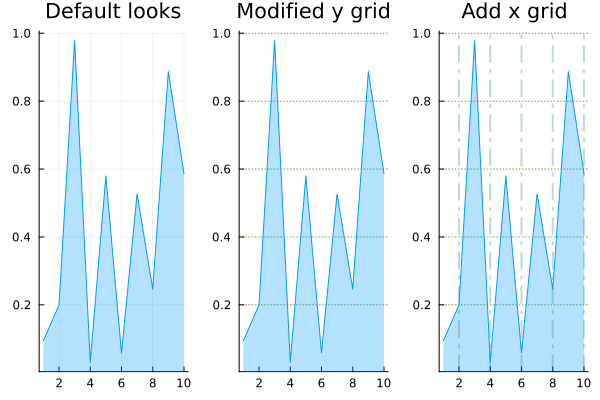

In [41]:
x = rand(10)
p1 = plot(x, title = "Default looks")
p2 = plot(x, grid = (:y, :olivedrab, :dot, 1, 0.9), title = "Modified y grid")
p3 = plot(deepcopy(p2), title = "Add x grid")
xgrid!(p3, :on, :cadetblue, 2, :dashdot, 0.4)
plot(p1, p2, p3, layout = (1, 3), label = "", fillrange = 0, fillalpha = 0.3)

## 32. 그래프 프레임 스타일

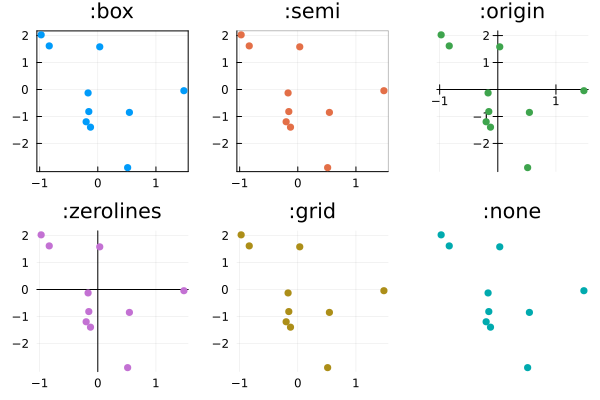

In [42]:
scatter(fill(randn(10), 6), fill(randn(10), 6), framestyle = [:box :semi :origin :zerolines :grid :none], title = [":box" ":semi" ":origin" ":zerolines" ":grid" ":none"], color = permutedims(1:6), layout = 6, label = "", markerstrokewidth = 0, ticks = -2:2)

## 33. 변화적 색상 넣기

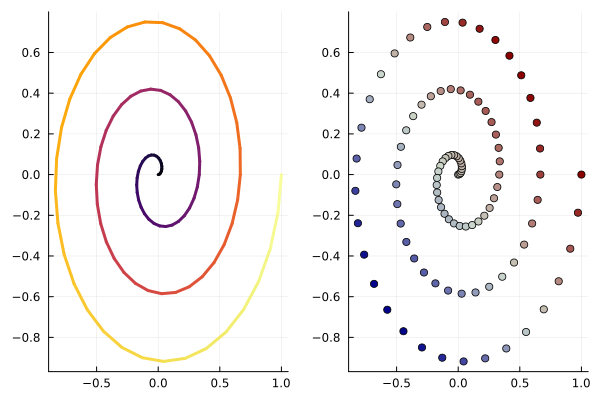

In [43]:
t = range(0, stop = 1, length = 100)
θ = (6π) .* t
x = t .* cos.(θ)
y = t .* sin.(θ)
p1 = plot(x, y, line_z = t, linewidth = 3, legend = false)
p2 = scatter(x, y, marker_z = (+), color = :bluesreds, legend = false)
plot(p1, p2)

## 33. 누적 혼합 그래프(portfolio composition maps)

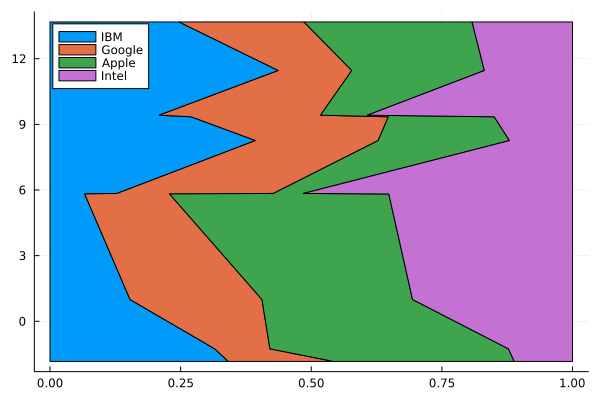

In [44]:
using Random
Random.seed!(111)
tickers = ["IBM", "Google", "Apple", "Intel"]
(N, D) = (10, length(tickers))
weights = rand(N, D)
weights ./= sum(weights, dims = 2)
returns = sort!((1:N) + D * randn(N))
portfoliocomposition(weights, returns, labels = permutedims(tickers))

## 34. 리본 그래프

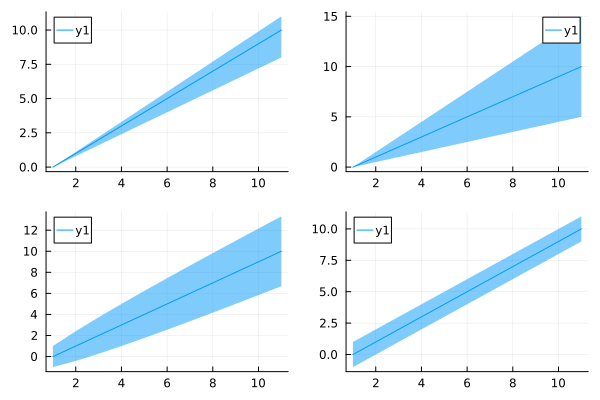

In [45]:
plot(plot(0:10; ribbon = (LinRange(0, 2, 11), LinRange(0, 1, 11))), plot(0:10; ribbon = 0:0.5:5), plot(0:10; ribbon = sqrt), plot(0:10; ribbon = 1))

## 35. 2D-히스토그램

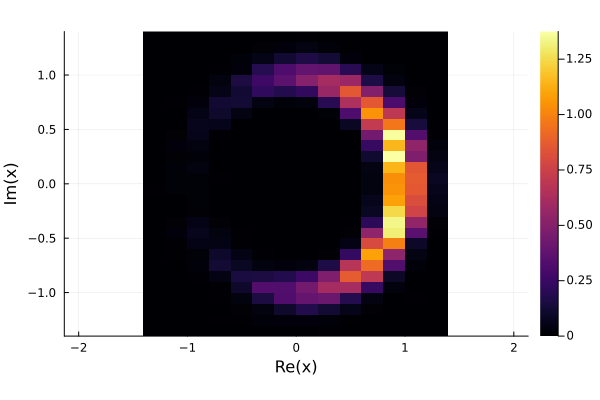

In [46]:
n = 10000
x = exp.(0.1 * randn(n) .+ randn(n) .* im)
histogram2d(x, nbins = (20, 40), show_empty_bins = true, normed = true, aspect_ratio = 1)

## 36. 불연속 그래프 그리기(missing or Nan)

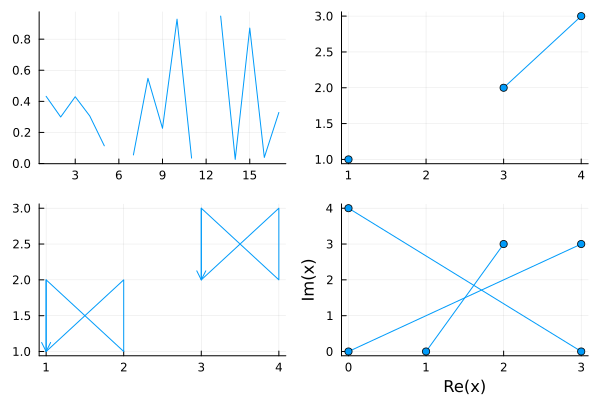

In [47]:
(x, y) = ([1, 2, 2, 1, 1], [1, 2, 1, 2, 1])
plot(plot([rand(5); NaN; rand(5); NaN; rand(5)]), plot([1, missing, 2, 3], marker = true), plot([x; NaN; x .+ 2], [y; NaN; y .+ 1], arrow = 2), plot([1, 2 + 3im, Inf, 4im, 3, -Inf * im, 0, 3 + 3im], marker = true), legend = false)

## 37. 렌즈 그래프 넣기

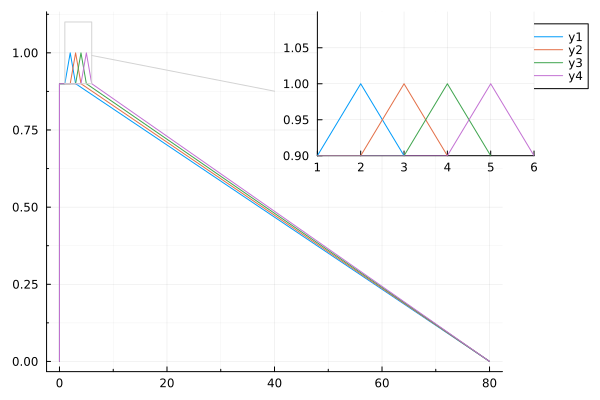

In [49]:
plot([(0, 0), (0, 0.9), (1, 0.9), (2, 1), (3, 0.9), (80, 0)], legend = :outertopright, minorgrid = true, minorticks = 2)
plot!([(0, 0), (0, 0.9), (2, 0.9), (3, 1), (4, 0.9), (80, 0)])
plot!([(0, 0), (0, 0.9), (3, 0.9), (4, 1), (5, 0.9), (80, 0)])
plot!([(0, 0), (0, 0.9), (4, 0.9), (5, 1), (6, 0.9), (80, 0)])
lens!([1, 6], [0.9, 1.1], inset = (1, bbox(0.5, 0.0, 0.4, 0.4)))

## 38. 배열 타입 그래프 그리기

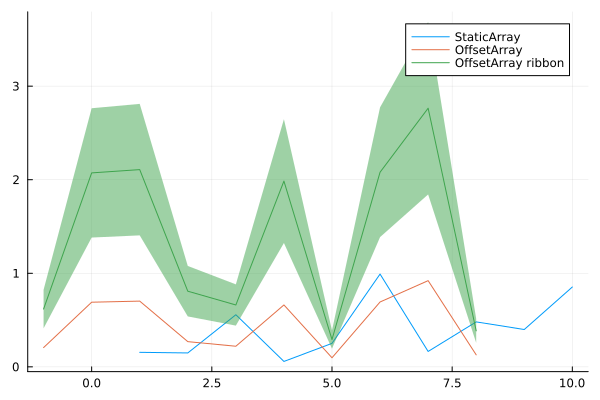

In [50]:
using StaticArrays, OffsetArrays
sv = SVector{10}(rand(10))
ov = OffsetVector(rand(10), -2)
plot(Any[sv, ov], label = ["StaticArray" "OffsetArray"])
plot!(3ov, ribbon = ov, label = "OffsetArray ribbon")

## 39. 폰트 바꾸기

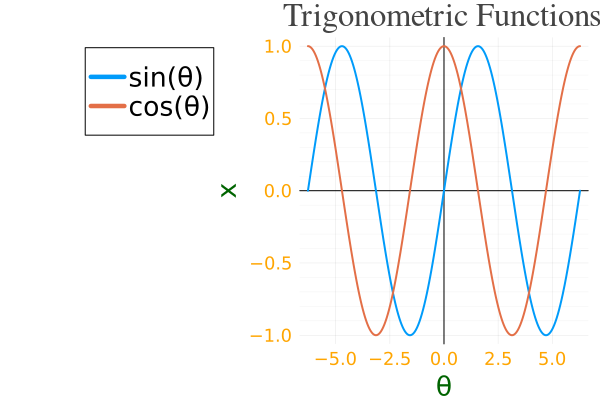

In [51]:
default(titlefont = (20, "times"), legendfontsize = 18, guidefont = (18, :darkgreen), tickfont = (12, :orange), guide = "x", framestyle = :zerolines, yminorgrid = true)
plot([sin, cos], -2π, 2π, label = ["sin(θ)" "cos(θ)"], title = "Trigonometric Functions", xlabel = "θ", linewidth = 2, legend = :outertopleft)

## 40. 날짜별 히트맵 그리기

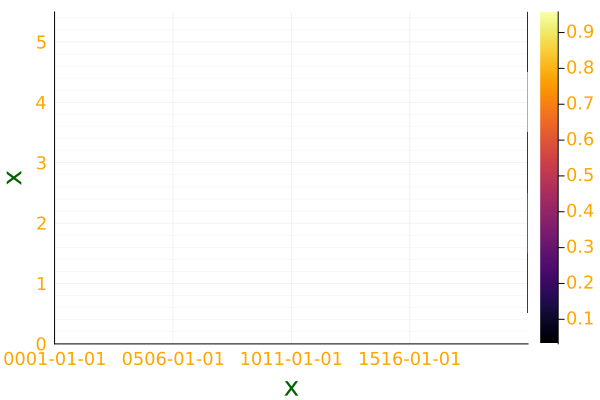

In [52]:
using Dates
heatmap(DateTime.(2016:2020), 1:5, rand(5, 5))

## 41. Linked axes

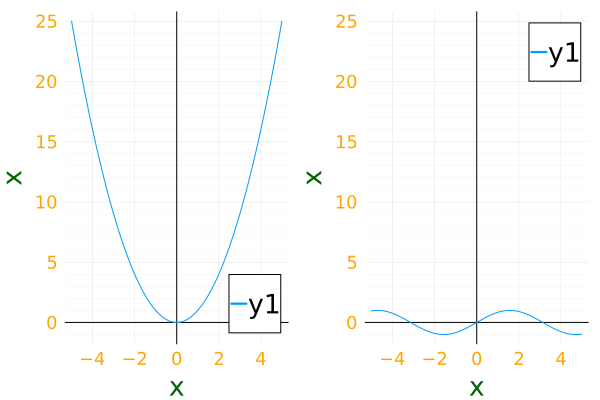

In [53]:
x = -5:0.1:5
plot(plot(x, (x->begin
                x ^ 2
            end)), plot(x, (x->begin
                sin(x)
            end)), layout = 2, link = :y)

## 42. 배열 타입 그래프에 에러바 넣기

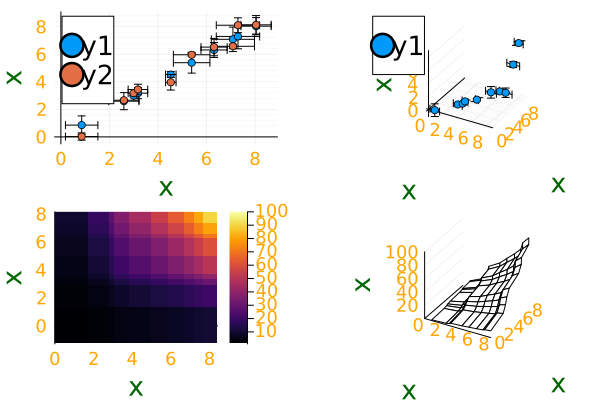

In [54]:
struct Measurement <: Number
    val::Float64
    err::Float64
end

value(m::Measurement) = begin
        m.val
    end

uncertainty(m::Measurement) = begin
        m.err
    end

@recipe function f(::Type{T}, m::T) where T <: AbstractArray{<:Measurement}
        if !(get(plotattributes, :seriestype, :path) in (:contour, :contourf, :contour3d, :heatmap, :surface, :wireframe, :image))
            error_sym = Symbol(plotattributes[:letter], :error)
            plotattributes[error_sym] = uncertainty.(m)
        end
        value.(m)
    end

x = Measurement.(10 * sort(rand(10)), rand(10))
y = Measurement.(10 * sort(rand(10)), rand(10))
z = Measurement.(10 * sort(rand(10)), rand(10))

surf = Measurement.((1:10) .* (1:10)', rand(10, 10))
plot(scatter(x, [x y]), scatter(x, y, z), heatmap(x, y, surf), wireframe(x, y, surf), legend = :topleft)

## 43. Tuples and points

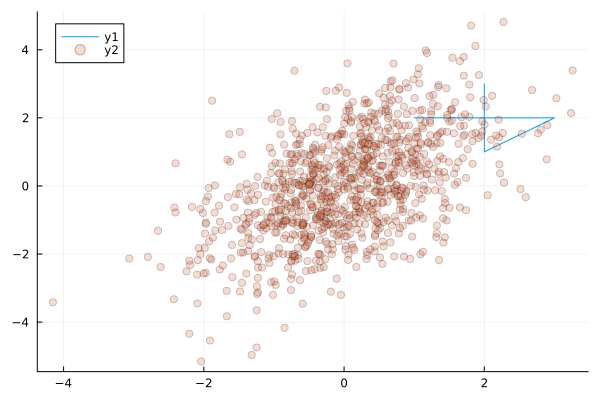

In [81]:
using GeometryBasics, Distributions
d = MvNormal([1.0 0.75; 0.75 2.0])
plot([(1, 2), (3, 2), (2, 1), (2, 3)])
scatter!(Point2.(eachcol(rand(d, 1000))), alpha = 0.25)

## 44. 3d-mesh

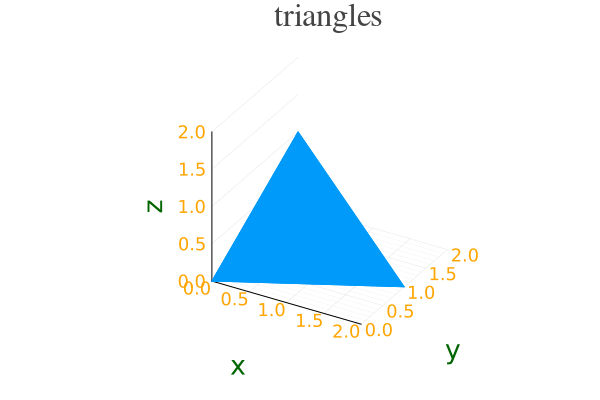

In [56]:
x = [0, 1, 2, 0]
y = [0, 0, 1, 2]
z = [0, 2, 0, 1]
i = [0, 0, 0, 1]
j = [1, 2, 3, 2]
k = [2, 3, 1, 3]
mesh3d(x, y, z; connections = (i, j, k), 
       title = "triangles", 
       xlabel = "x", 
       ylabel = "y", 
       zlabel = "z", 
       legend = :none, 
       margin = 2 * Plots.mm)

## 45. Vectors of markershapes and segments

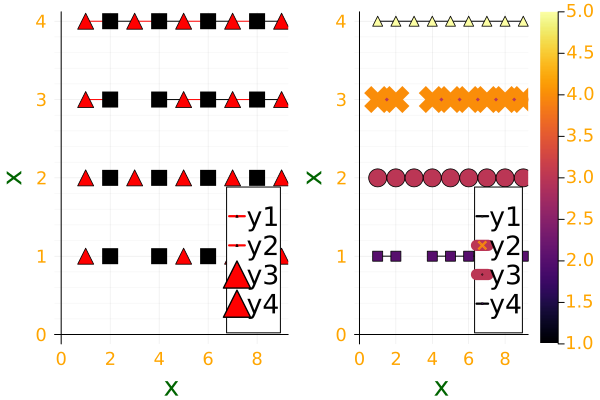

In [57]:
using Base.Iterators: cycle, take
yv = ones(9)
ys = [1; 1; NaN; ones(6)]
y = 5 .- [yv 2ys 3yv 4ys]
plt_color_rows = plot(y, 
                      seriestype = [:path :path :scatter :scatter], 
                      markershape = collect(take(cycle((:utriangle, :rect)), 9)), 
                      markersize = 8, 
                      color = collect(take(cycle((:red, :black)), 9)))
plt_z_cols = plot(y, 
                  markershape = [:utriangle :x :circle :square], 
                  markersize = [5 10 10 5], 
                  marker_z = [5 4 3 2], 
                  line_z = [1 3 3 1], linewidth = [1 10 5 1])
plot(plt_color_rows, plt_z_cols)

## 46. Polar heatmaps

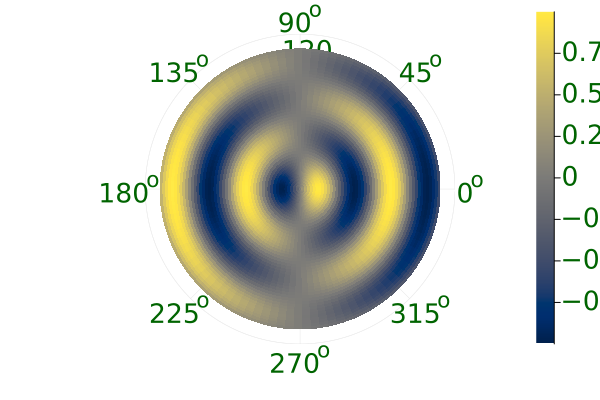

In [58]:
θ = range(0, 2π; length = 100)
ρ = range(0, 120; length = 50)
z = sin.(ρ ./ 10) .* (cos.(θ))'
heatmap(θ, ρ, z; projection = :polar, color = :cividis, right_margin = 2 * Plots.mm)

## 47. 3D surface with axis guides

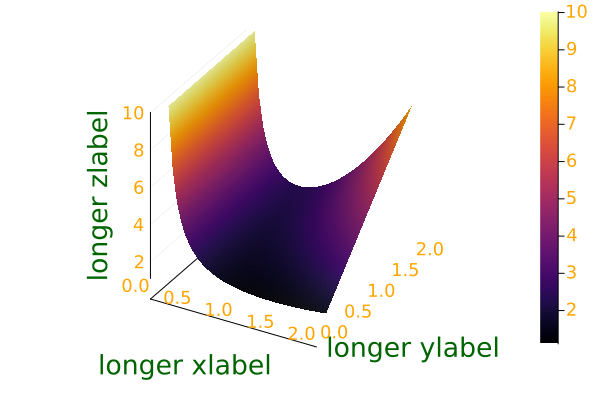

In [59]:
xs = collect(0.1:0.05:2.0)
ys = collect(0.2:0.1:2.0)
X = [x for x = xs for _ = ys]
Y = [y for _ = xs for y = ys]
Z = ((x, y)->begin
            1 / x + y * x ^ 2
        end)
surface(X, Y, Z.(X, Y), xlabel = "longer xlabel", ylabel = "longer ylabel", zlabel = "longer zlabel")

## 48. Images with custom axes

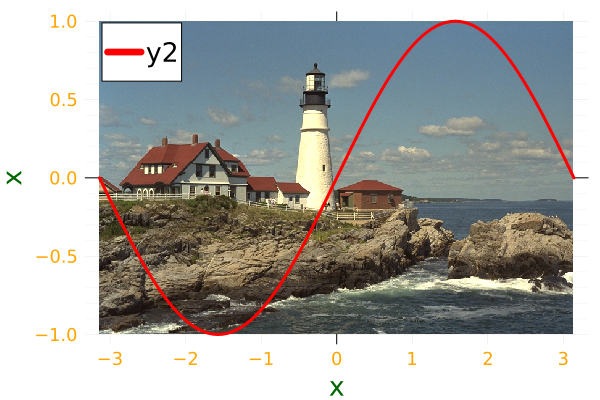

In [60]:
using TestImages
img = testimage("lighthouse")
plot([-π, π], [-1, 1], reverse(img, dims = 1), yflip = false, aspect_ratio = :none)
plot!(sin, -π, π, lw = 3, color = :red)

## 49. 3D quiver 그래프

- quiver() 함수는 각 장의 벡터 성분을 시각화하는데 사용하는 함수로  X, Y, Z로 지정된 카테시안 좌표에서 방향 성분 U, V, W를 사용하여 화살표를 플로팅합니다.

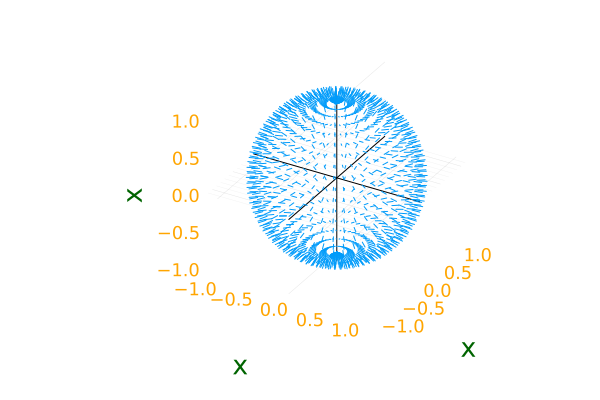

In [61]:
ϕs = range(-π, π, length = 50)
θs = range(0, π, length = 25)
θqs = range(1, π - 1, length = 25)
x = vec([sin(θ) * cos(ϕ) for (ϕ, θ) = Iterators.product(ϕs, θs)])
y = vec([sin(θ) * sin(ϕ) for (ϕ, θ) = Iterators.product(ϕs, θs)])
z = vec([cos(θ) for (ϕ, θ) = Iterators.product(ϕs, θs)])
u = 0.1 * vec([sin(θ) * cos(ϕ) for (ϕ, θ) = Iterators.product(ϕs, θqs)])
v = 0.1 * vec([sin(θ) * sin(ϕ) for (ϕ, θ) = Iterators.product(ϕs, θqs)])
w = 0.1 * vec([cos(θ) for (ϕ, θ) = Iterators.product(ϕs, θqs)])
quiver(x, y, z, quiver = (u, v, w))

## 50. 타입별 step 함수

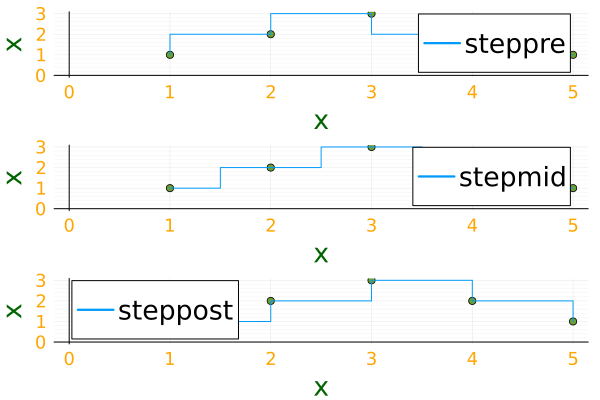

In [62]:
x = 1:5
y = [1, 2, 3, 2, 1]
default(shape = :circle)
plot(plot(x, y, markershape = :circle, seriestype = :steppre, label = "steppre"), 
    plot(x, y, markershape = :circle, seriestype = :stepmid, label = "stepmid"), 
    plot(x, y, markershape = :circle, seriestype = :steppost, label = "steppost"), 
    layout = (3, 1))

## 51. x, y 가이드 포지션 잡기

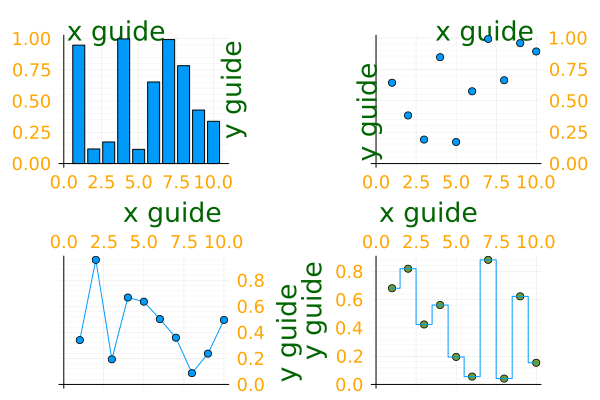

In [63]:
plot(rand(10, 4), 
    layout = 4, 
    xguide = "x guide", 
    yguide = "y guide", 
    xguidefonthalign = [:left :right :right :left], 
    yguidefontvalign = [:top :bottom :bottom :top], 
    xguideposition = :top, 
    yguideposition = [:right :left :right :left], 
    ymirror = [false true true false], 
    xmirror = [false false true true], 
    legend = false, 
    seriestype = [:bar :scatter :path :stepmid])

## 52. 3D plot의 flipping

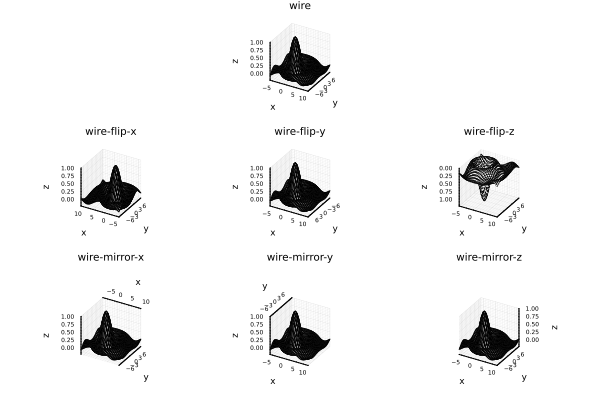

In [64]:
using LinearAlgebra
with(scalefonts = 0.5) do
    (x, y) = (collect(-6:0.5:10), collect(-8:0.5:8))
    args = (x, y, ((x, y)->begin
                    sinc(norm([x, y]) / π)
                end))
    kw = (xlabel = "x", ylabel = "y", zlabel = "z", grid = true, minorgrid = true)
    plots = [wireframe(args..., title = "wire"; kw...)]
    for ax = (:x, :y, :z)
        push!(plots, wireframe(args..., title = "wire-flip-$(ax)", xflip = ax === :x, yflip = ax === :y, zflip = ax === :z; kw...))
    end
    for ax = (:x, :y, :z)
        push!(plots, wireframe(args..., title = "wire-mirror-$(ax)", xmirror = ax === :x, ymirror = ax === :y, zmirror = ax === :z; kw...))
    end
    plot(plots..., layout = @layout([_ ° _; ° ° °; ° ° °]), margin = 0 * Plots.px)
end

## 53. bar plot 겹쳐 그리기

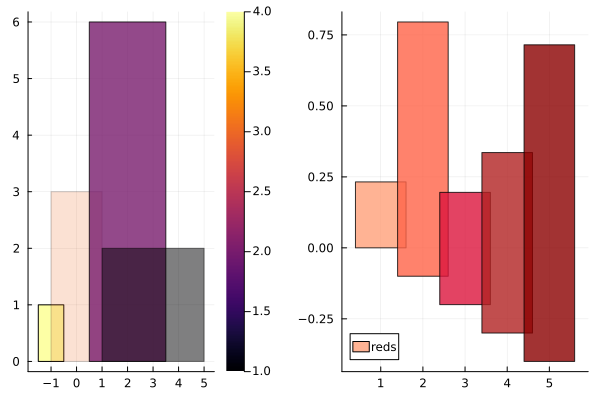

In [65]:
plot(bar([-1, 0, 2, 3], [1, 3, 6, 2], fill_z = 4:-1:1, alpha = [1, 0.2, 0.8, 0.5], label = "", bar_width = 1:4), bar(rand(5), bar_width = 1.2, alpha = 0.8, color = [:lightsalmon, :tomato, :crimson, :firebrick, :darkred], fillto = 0:-0.1:-0.4, label = "reds"))

## 54. vertical and horizontal spans

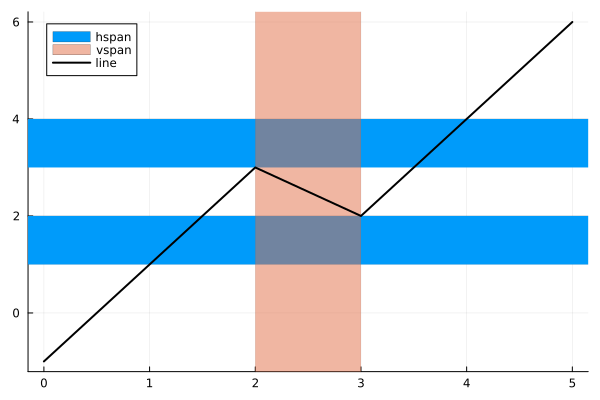

In [66]:
hspan([1, 2, 3, 4]; label = "hspan", legend = :topleft)
vspan!([2, 3]; alpha = 0.5, label = "vspan")
plot!([0, 2, 3, 5], [-1, 3, 2, 6]; c = :black, lw = 2, label = "line")

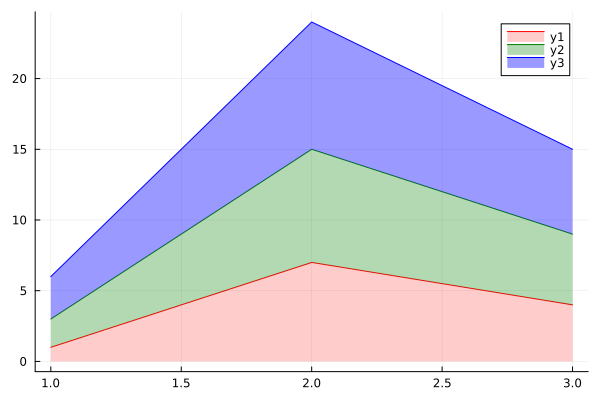

In [67]:
areaplot(1:3, [1 2 3; 7 8 9; 4 5 6], seriescolor = [:red :green :blue], fillalpha = [0.2 0.3 0.4])

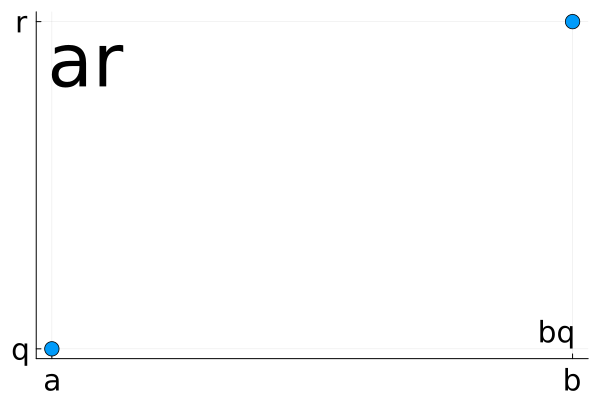

In [68]:
(x, y) = (["a", "b", "c"], [1, 5, 15])
p = scatter(["a", "b"], ["q", "r"], ms = 8, legend = false, tickfontsize = 20)
annotate!(["a", "b"], ["r", "q"], [text("ar", :top, :left, 50), text("bq", :bottom, :right, 20)])

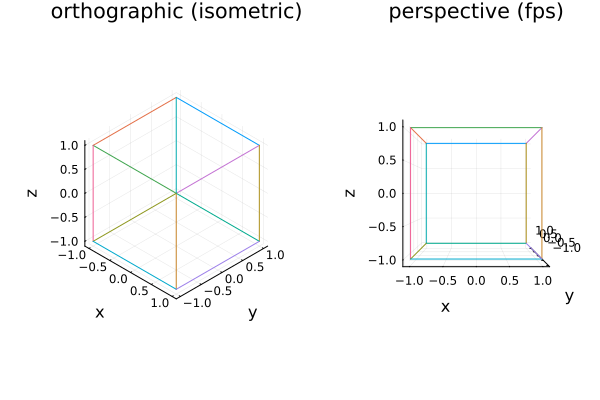

In [69]:
x = [[-1, 1], [-1, -1], [-1, 1], [1, 1], [1, 1], [-1, -1], [-1, -1], [1, 1], [-1, 1], [-1, -1], [-1, 1], [1, 1]]
y = [[1, 1], [-1, 1], [-1, -1], [-1, 1], [1, 1], [1, 1], [-1, -1], [-1, -1], [1, 1], [-1, 1], [-1, -1], [-1, 1]]
z = [[1, 1], [1, 1], [1, 1], [1, 1], [-1, 1], [-1, 1], [-1, 1], [-1, 1], [-1, -1], [-1, -1], [-1, -1], [-1, -1]]
kw = (aspect_ratio = :equal, label = :none, xlabel = "x", ylabel = "y", zlabel = "z", xlims = (-1.1, 1.1), ylims = (-1.1, 1.1), zlims = (-1.1, 1.1))
plot(plot(x, y, z; proj_type = :ortho, title = "orthographic (isometric)", camera = (45, round(atand(1 / √2); digits = 3)), kw...), plot(x, y, z; proj_type = :persp, title = "perspective (fps)", camera = (0, 0), kw...))

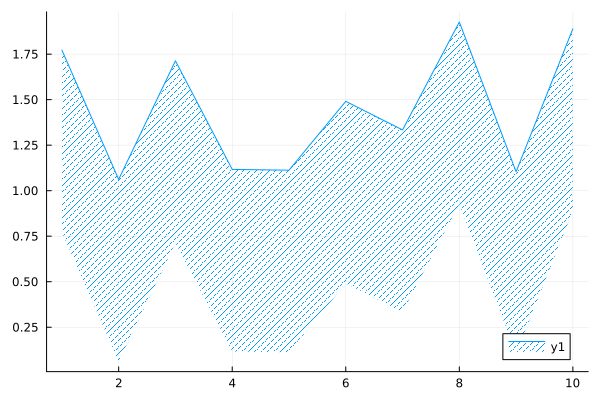

In [70]:
y = rand(10)
plot(y .+ 1, fillrange = y, fillstyle = :/)

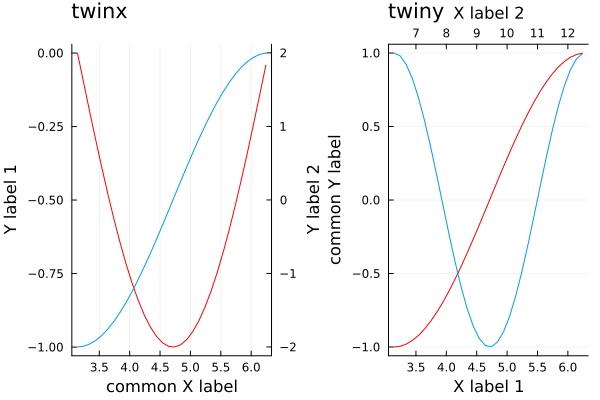

In [71]:
kw = (; lab = "", title_loc = :left)
x = π:0.1:2π
plot(x, sin.(x), xaxis = "common X label", yaxis = "Y label 1", color = :red, title = "twinx"; kw...)
pl = plot!(twinx(), x, 2 * cos.(x), yaxis = "Y label 2"; kw...)
plot(x, cos.(x), xaxis = "X label 1", yaxis = "common Y label", color = :red, title = "twiny"; kw...)
pr = plot!(twiny(), 2x, cos.(2x), xaxis = "X label 2"; kw...)
plot(pl, pr)

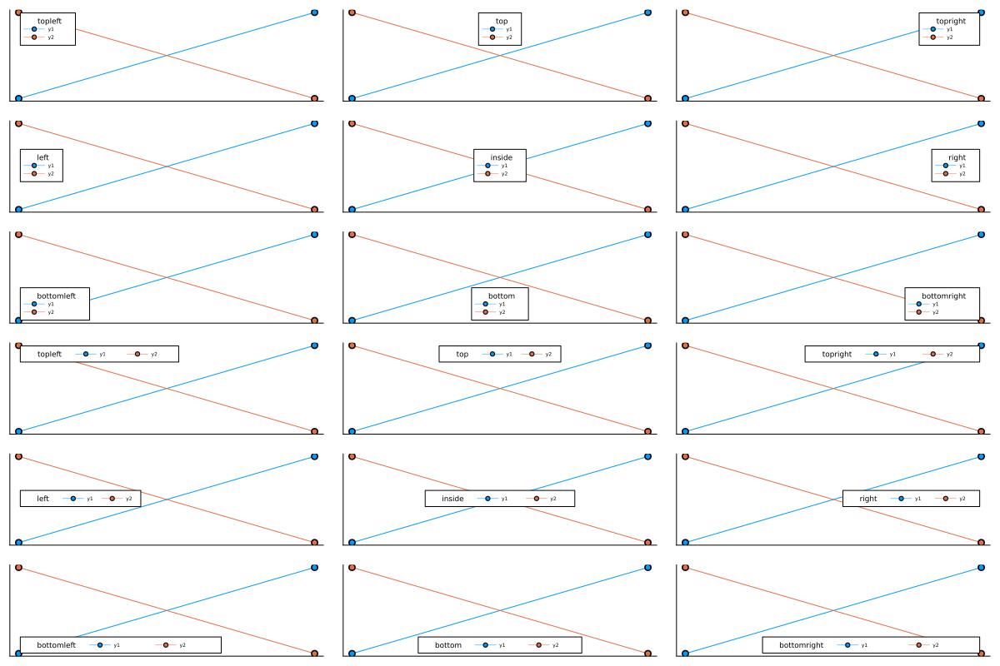

In [72]:
legs = (:topleft, :top, :topright, :left, :inside, :right, :bottomleft, :bottom, :bottomright)
leg_plots(; kw...) = begin
        map((leg->begin
                    plot([0:1, reverse(0:1)]; marker = :circle, ticks = :none, leg_title = leg, leg, kw...)
                end), legs)
    end
(w, h) = Plots._plot_defaults[:size]
with(scalefonts = 0.5, size = (2w, 2h)) do
    plot(leg_plots()..., leg_plots(legend_column = -1)...; layout = (6, 3))
end

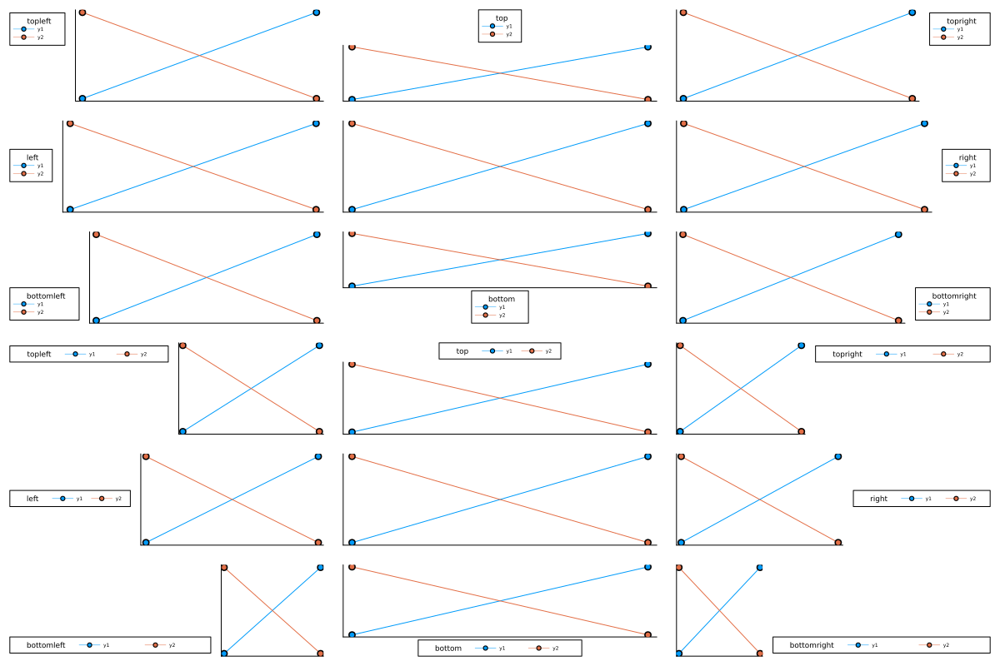

In [73]:
legs = (:topleft, :top, :topright, :left, nothing, :right, :bottomleft, :bottom, :bottomright)
leg_plots(; kw...) = begin
        map((leg->begin
                    plot([0:1, reverse(0:1)]; marker = :circle, ticks = :none, leg_title = leg, leg = if leg isa Symbol
                                Symbol(:outer, leg)
                            else
                                :none
                            end, kw...)
                end), legs)
    end
(w, h) = Plots._plot_defaults[:size]
with(scalefonts = 0.5, size = (2w, 2h)) do
    plot(leg_plots()..., leg_plots(legend_column = -1)...; layout = (6, 3))
end

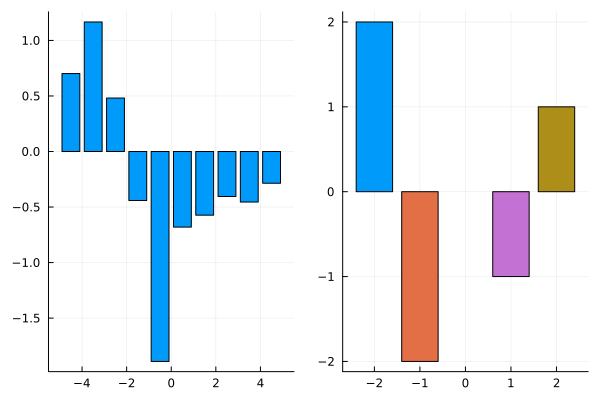

In [74]:
plot(bar(-5:5, randn(10)), bar(-2:2, [2, -2, NaN, -1, 1], color = 1:5), legend = false)